# Loan Approval using Pyspark

## Project Description

The objective of this project is to analyze and predict the outcomes of bank loan applications using a dataset containing 148,000 records of applicant and loan information. The dataset includes critical features such as loan amount, applicant's demographics, annual income, credit score, and the purpose of the loan, among others. The target variable, status, indicates whether a loan was approved (0) or denied (1). By studying patterns and trends within these features, the goal is to build a predictive model that can accurately forecast loan approval decisions, helping banks streamline their evaluation processes and manage risks effectively.


## Project Dataset Details:

The dataset consists of 148,671 rows with each row representing the claim details and 37 columns contains vehicle dataset - id, loan, gender, age, loan purpose, credit_score etc.

#### Dataset Source:
- **Kaggle**: https://www.kaggle.com/datasets/ychope/loan-approval-dataset

## Dataset Variables Description

### 1. Target Variable: status

  Description: The target variable indicates whether the loan application was approved or denied.
  Data Type: Integer (or Boolean)

  Values:
    - 0: Loan approved.
    - 1: Loan denied.

### 2. Predictor Variables in the Dataset:
Demographic & Applicant Information:

#### gender:
  Description: The gender of the applicant.

  Data Type: Categorical (String)

  Values:
  - Male
  - Female
  - Unknown (if not specified)

#### age:

  Description: Age of the applicant.

  Data Type: Numeric (Integer)

  Values: Age in years (e.g., 25, 35, 50)

#### income:

  Description: The annual income of the applicant.

  Data Type: Numeric (Float or Integer)

  Values: Income value in the local currency (e.g., USD, INR)

#### credit_score:

  Description: The applicant's credit score based on their financial history.

  Data Type: Numeric (Integer)

  Values: A numerical score (e.g., 650, 700, 800) reflecting the applicant’s creditworthiness.

#### loan_amount:

  Description: The total amount of the loan requested by the applicant.

  Data Type: Numeric (Integer or Float)

  Values: The loan amount in the local currency (e.g., USD, INR).

#### loan_limit:

  Description: The maximum allowable loan amount based on the applicant’s income, credit score, and other factors.

  Data Type: Categorical (String)

  Values:

  - Low
  - Medium
  - High
  - Unknown

#### loan_type:

  Description: The type of loan being requested by the applicant (e.g., personal loan, mortgage, etc.).

  Data Type: Categorical (String)

  Values:

  - Personal
  - Mortgage
  - Business
  - Other

#### loan_purpose:

  Description: The purpose for which the applicant is requesting the loan (e.g., for buying a home, starting a business, etc.).

  Data Type: Categorical (String)

  Values:

  - Home
  - Business
  - Car
  - Personal
  - Education
  - Debt Consolidation
  - Other

#### region:

  Description: The geographic region where the applicant resides.

  Data Type: Categorical (String)

  Values: Examples could be Urban, Suburban, Rural, or specific geographic regions like North, South, etc.

#### employment_status:

  Description: The employment status of the applicant.

  Data Type: Categorical (String)

  Values:

  - Employed
  - Unemployed
  - Self-Employed
  - Student
  - Retired

#### interest_rate:

  Description: The interest rate applied to the loan.

  Data Type: Numeric (Float or Integer)

  Values: The percentage rate applied to the loan (e.g., 5.0, 10.5).

#### debt_to_income_ratio (dtir1):

  Description: The ratio of the applicant's monthly debt payments to their monthly income.

  Data Type: Numeric (Float)

  Values: A ratio (e.g., 0.25 means 25% of the applicant's income goes towards debt repayment).


## Important Pyspark Libraries

In [0]:
#libraries imported for processing
import numpy as np #matematical computations
import matplotlib.pyplot as plt #plotting
import seaborn as sns #plotting
import warnings
import scipy.stats as ss #statistical computations
import math #mathematical computations
import pyspark.sql.functions as F
import pyspark.sql.types as T
import matplotlib.pyplot as plt

from itertools import product
from pyspark.ml import Pipeline, PipelineModel
from pyspark.ml.feature import StringIndexer, VectorAssembler, StandardScaler
from pyspark.ml.classification import LogisticRegression, RandomForestClassifier, GBTClassifier, NaiveBayes
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator
from pyspark.sql.functions import col, when, sum, sort_array, collect_list, round

from pyspark.sql.types import StringType, BooleanType

warnings.filterwarnings("ignore")
#pd.set_option('display.max_columns', None)

## Removing if the Loan Data Csv file already Exists in driver

In [0]:
rm /databricks/driver/Loan


rm: cannot remove '/databricks/driver/Loan': No such file or directory


## Loading Driver Content

In [0]:
ls -lrt /databricks/driver

total 1300
drwxr-xr-x 2 root root    4096 Dec 13 01:26 conf/
-r-xr-xr-x 1 root root    2755 Dec 13 01:27 hadoop_accessed_config.lst*
drwxr-xr-x 2 root root    4096 Dec 13 01:27 azure/
-r-xr-xr-x 1 root root 1306936 Dec 13 01:27 preload_class.lst*
drwxr-xr-x 3 root root    4096 Dec 13 21:39 eventlogs/
drwxr-xr-x 2 root root    4096 Dec 13 21:39 logs/


## Installing Kaggle

In [0]:
%sh
pip install kaggle

  Created wheel for kaggle: filename=kaggle-1.6.17-py3-none-any.whl size=105803 sha256=0e86b27ce58edd15a6c7bb7569bd9810a0d65e30347e733bfe0cb9c3b833d6b8
  Stored in directory: /root/.cache/pip/wheels/2b/af/a9/70bffa2773af622d2ebea9c8d407720b86e67bd40c465bf837
Successfully built kaggle
  Attempting uninstall: certifi
    Found existing installation: certifi 2021.10.8
    Not uninstalling certifi at /databricks/python3/lib/python3.9/site-packages, outside environment /local_disk0/.ephemeral_nfs/envs/pythonEnv-595a272d-6481-4066-9cf3-e0e21d36305e
    Can't uninstall 'certifi'. No files were found to uninstall.
You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-595a272d-6481-4066-9cf3-e0e21d36305e/bin/python -m pip install --upgrade pip' command.


## Retreving the Data from Kaggle

In [0]:
%sh
export KAGGLE_USERNAME=divyavemula696 
export KAGGLE_KEY=e6a8bcb2cb4f105d654e17cbe054bf4c
kaggle datasets download -d ychope/loan-approval-dataset 
ls -lrt

Dataset URL: https://www.kaggle.com/datasets/ychope/loan-approval-dataset
License(s): CC0-1.0

  0%|          | 0.00/5.81M [00:00<?, ?B/s]
 17%|█▋        | 1.00M/5.81M [00:00<00:00, 8.70MB/s]
 34%|███▍      | 2.00M/5.81M [00:00<00:00, 9.10MB/s]
 52%|█████▏    | 3.00M/5.81M [00:00<00:00, 9.36MB/s]
 69%|██████▉   | 4.00M/5.81M [00:00<00:00, 9.24MB/s]
100%|██████████| 5.81M/5.81M [00:00<00:00, 11.9MB/s]

total 7248
-rw-r--r-- 1 root root 6088411 Apr 30  2022 loan-approval-dataset.zip
drwxr-xr-x 2 root root    4096 Dec 13 01:26 conf
-r-xr-xr-x 1 root root    2755 Dec 13 01:27 hadoop_accessed_config.lst
drwxr-xr-x 2 root root    4096 Dec 13 01:27 azure
-r-xr-xr-x 1 root root 1306936 Dec 13 01:27 preload_class.lst
drwxr-xr-x 3 root root    4096 Dec 13 21:39 eventlogs
drwxr-xr-x 2 root root    4096 Dec 13 21:39 logs


## Extracting the Zipped data

In [0]:
%sh
unzip loan-approval-dataset.zip
ls -lrt


Archive:  loan-approval-dataset.zip
  inflating: Loan.csv                
total 36636
-rw-r--r-- 1 root root 30093102 Apr 30  2022 Loan.csv
-rw-r--r-- 1 root root  6088411 Apr 30  2022 loan-approval-dataset.zip
drwxr-xr-x 2 root root     4096 Dec 13 01:26 conf
-r-xr-xr-x 1 root root     2755 Dec 13 01:27 hadoop_accessed_config.lst
drwxr-xr-x 2 root root     4096 Dec 13 01:27 azure
-r-xr-xr-x 1 root root  1306936 Dec 13 01:27 preload_class.lst
drwxr-xr-x 3 root root     4096 Dec 13 21:39 eventlogs
drwxr-xr-x 2 root root     4096 Dec 13 21:39 logs


## Loading the Driver Data

In [0]:
%sh

ls -lrt /databricks/driver/

total 36636
-rw-r--r-- 1 root root 30093102 Apr 30  2022 Loan.csv
-rw-r--r-- 1 root root  6088411 Apr 30  2022 loan-approval-dataset.zip
drwxr-xr-x 2 root root     4096 Dec 13 01:26 conf
-r-xr-xr-x 1 root root     2755 Dec 13 01:27 hadoop_accessed_config.lst
drwxr-xr-x 2 root root     4096 Dec 13 01:27 azure
-r-xr-xr-x 1 root root  1306936 Dec 13 01:27 preload_class.lst
drwxr-xr-x 3 root root     4096 Dec 13 21:39 eventlogs
drwxr-xr-x 2 root root     4096 Dec 13 21:39 logs


## Reading the Loan.csv file from the Driver

In [0]:
# Function to load and preprocess data
def load_data(file_path):
    """
    Load the CSV data into a Spark DataFrame.
    Args:
    - file_path (str): Path to the CSV file
    
    Returns:
    - df (DataFrame): Loaded DataFrame
    """
    # Load the dataset
    df = spark.read.csv(file_path, header=True, inferSchema=True)

    return df

# Load the data
df = load_data("file:/databricks/driver/Loan.csv")


### Dimensions of the dataset (rows, columns)

In [0]:
# Display number of rows and columns
num_rows = df.count()  # Get number of rows
num_columns = len(df.columns)  # Get number of columns

print(f"Number of rows: {num_rows}")
print(f"Number of columns: {num_columns}")


Number of rows: 148670
Number of columns: 37


## Data Fields Description

In [0]:
df.describe()

Out[10]: DataFrame[summary: string, _c0: string, id: string, year: string, loan_limit: string, gender: string, approv_in_adv: string, loan_type: string, loan_purpose: string, credit_worthiness: string, open_credit: string, business_or_commercial: string, loan_amount: string, rate_of_interest: string, interest_rate_spread: string, upfront_charges: string, term: string, neg_ammortization: string, interest_only: string, lump_sum_payment: string, property_value: string, construction_type: string, occupancy_type: string, secured_by: string, total_units: string, income: string, credit_type: string, credit_score: string, co-applicant_credit_type: string, age: string, submission_of_application: string, ltv: string, region: string, security_type: string, status: string, dtir1: string, high_interest_rate: string, senior_age: string]

## UnCleaned or Raw Data Schema

In [0]:
# This section includes the initialization of Spark session and loading of data

# Display DataFrame Schema to understand data structure
display(df.printSchema())


root
 |-- _c0: integer (nullable = true)
 |-- id: integer (nullable = true)
 |-- year: integer (nullable = true)
 |-- loan_limit: string (nullable = true)
 |-- gender: string (nullable = true)
 |-- approv_in_adv: string (nullable = true)
 |-- loan_type: string (nullable = true)
 |-- loan_purpose: string (nullable = true)
 |-- credit_worthiness: string (nullable = true)
 |-- open_credit: string (nullable = true)
 |-- business_or_commercial: string (nullable = true)
 |-- loan_amount: integer (nullable = true)
 |-- rate_of_interest: double (nullable = true)
 |-- interest_rate_spread: double (nullable = true)
 |-- upfront_charges: double (nullable = true)
 |-- term: double (nullable = true)
 |-- neg_ammortization: string (nullable = true)
 |-- interest_only: string (nullable = true)
 |-- lump_sum_payment: string (nullable = true)
 |-- property_value: double (nullable = true)
 |-- construction_type: string (nullable = true)
 |-- occupancy_type: string (nullable = true)
 |-- secured_by: stri

## Target Field(s) Described and Highlighted

In [0]:
# Target variable: 'status' (approved/denied)
target_field = 'status'

# Describe target field
df.select(target_field).distinct().show()


+------+
|status|
+------+
|     1|
|     0|
+------+



## Count the number of loans by status

In [0]:

# Product line by purchases
df.select('status').groupBy('status').count().show()

+------+------+
|status| count|
+------+------+
|     1| 36639|
|     0|112031|
+------+------+



## Data statistical summary on raw data

In [0]:
# Summary of Raw Data
display(df.summary())

summary,_c0,id,year,loan_limit,gender,approv_in_adv,loan_type,loan_purpose,credit_worthiness,open_credit,business_or_commercial,loan_amount,rate_of_interest,interest_rate_spread,upfront_charges,term,neg_ammortization,interest_only,lump_sum_payment,property_value,construction_type,occupancy_type,secured_by,total_units,income,credit_type,credit_score,co-applicant_credit_type,age,submission_of_application,ltv,region,security_type,status,dtir1,high_interest_rate,senior_age
count,148670,148670,148670,145326,148670,147762,148670,148536,148670,148670,148670,148670,148670,112031,109028,148629,148549,148670,148670,133572,148670,148670,148670,148670,139520,148670,148670,148670,148470,148470,133572,148670,148670,148670,124549,148670,148670
mean,74334.5,99224.5,2019.0,null,null,null,null,null,null,null,null,331117.7439967714,2.8088302616532466,0.441655660486831,3224.9961265913516,335.1365816899797,null,null,null,497893.46569640347,null,null,null,null,6957.338876146789,null,699.7891033833322,null,null,null,72.74645733387126,null,null,0.24644514696979888,37.73293242017198,0.3336853433779512,0.40662541198627833
stddev,42917.47659753543,42917.47659753543,0.0,null,null,null,null,null,null,null,null,183909.31012708554,2.224436670978976,0.513042735784729,3251.121509710329,58.40908350896435,null,null,null,359935.3155619442,null,null,null,null,6496.586382220254,null,115.87585660446848,null,null,null,39.96760298303222,null,null,0.43094220686213175,10.54543492987369,0.4715304131505786,0.49120546541688287
min,0,24890,2019,cf,Female,nopre,type1,p1,l1,nopc,b/c,16500,-1.0,-3.638,0.0,96.0,neg_amm,int_only,lpsm,8000.0,mh,ir,home,1U,0.0,CIB,500,CIB,25-34,not_inst,0.967478198,North,Indriect,0,5.0,0,0
25%,37155,62045,2019,null,null,null,null,null,null,null,null,196500,2.75,0.0759,581.15,360.0,null,null,null,268000.0,null,null,null,null,3720.0,null,599,null,null,null,60.47486034,null,null,0,31.0,0,0
50%,74323,99213,2019,null,null,null,null,null,null,null,null,296500,3.75,0.3903,2595.32,360.0,null,null,null,418000.0,null,null,null,null,5760.0,null,699,null,null,null,75.13586957,null,null,0,39.0,0,0
75%,111487,136377,2019,null,null,null,null,null,null,null,null,436500,4.25,0.7752,4812.0,360.0,null,null,null,628000.0,null,null,null,null,8520.0,null,800,null,null,null,86.18421053,null,null,0,45.0,1,1
max,148669,173559,2019,ncf,Sex Not Available,pre,type3,p4,l2,opc,nob/c,3576500,8.0,3.3569999999999998,60000.0,360.0,not_neg,not_int,not_lpsm,1.6508E7,sb,sr,land,4U,578580.0,EXP,900,EXP,>74,to_inst,7831.25,south,direct,1,61.0,1,1


## Raw Data table

In [0]:
# Create a DataFrame

display(df.limit(5))


_c0,id,year,loan_limit,gender,approv_in_adv,loan_type,loan_purpose,credit_worthiness,open_credit,business_or_commercial,loan_amount,rate_of_interest,interest_rate_spread,upfront_charges,term,neg_ammortization,interest_only,lump_sum_payment,property_value,construction_type,occupancy_type,secured_by,total_units,income,credit_type,credit_score,co-applicant_credit_type,age,submission_of_application,ltv,region,security_type,status,dtir1,high_interest_rate,senior_age
126324,151214,2019,ncf,Male,nopre,type1,p3,l1,nopc,nob/c,986500,4.125,0.6174,9825.0,360.0,neg_amm,not_int,not_lpsm,1408000.0,sb,pr,home,1U,13380.0,CIB,864,EXP,35-44,to_inst,70.06392045,North,direct,0,42.0,1,0
13385,38275,2019,cf,Joint,nopre,type1,p4,l1,nopc,nob/c,406500,3.625,-0.19899999999999998,1100.0,360.0,not_neg,not_int,not_lpsm,1008000.0,sb,pr,home,1U,5640.0,CRIF,505,EXP,>74,not_inst,40.32738095,North,direct,0,40.0,0,1
98606,123496,2019,cf,Sex Not Available,nopre,type1,p3,l1,nopc,nob/c,166500,4.25,0.7779,2379.51,180.0,not_neg,not_int,not_lpsm,338000.0,sb,pr,home,1U,4740.0,CRIF,829,CIB,55-64,to_inst,49.26035503,south,direct,0,29.0,1,1
7184,32074,2019,cf,Female,nopre,type1,p3,l1,nopc,nob/c,206500,5.625,1.1174,6117.5,360.0,not_neg,not_int,not_lpsm,278000.0,sb,pr,home,1U,3780.0,EXP,763,CIB,35-44,to_inst,74.28057554,North,direct,0,44.0,1,0
120745,145635,2019,cf,Male,nopre,type1,p1,l1,nopc,nob/c,166500,3.5,0.1533,779.88,360.0,not_neg,not_int,not_lpsm,168000.0,sb,pr,home,1U,2400.0,CIB,886,CIB,35-44,not_inst,99.10714286,North,direct,0,42.0,0,0


## Check for Duplicate Rows

In [0]:
num_duplicates = df.count() - df.distinct().count()
print(f"Number of duplicate rows: {num_duplicates}")

Number of duplicate rows: 0


## Data Visualizations

### Plot-1: Histogram For Raw Data

In [0]:
missing_values = df.select([F.sum(F.col(c).isNull().cast("int")).alias(c) for c in df.columns]).toPandas()

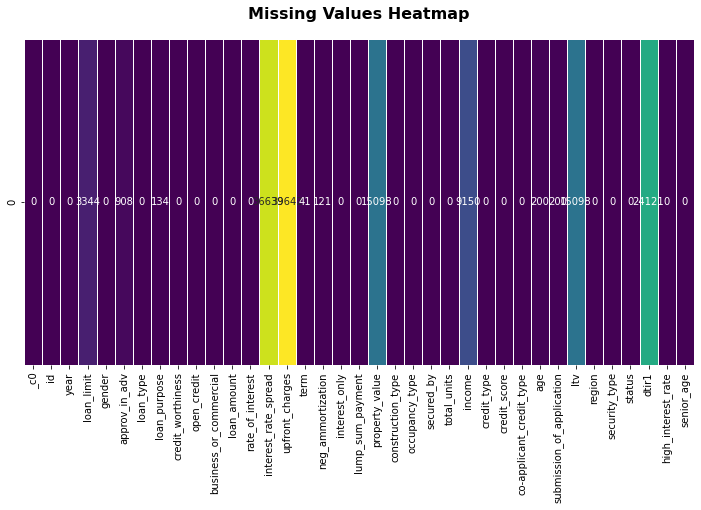

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt
from pyspark.sql import functions as F
from pyspark.sql.types import IntegerType, FloatType

# Set the figure size
plt.figure(figsize=(12, 6))

# Create the heatmap with improved aesthetics
sns.heatmap(missing_values, annot=True, cmap='viridis', cbar=False, fmt='g', linewidths=0.5, linecolor='white')

# Add a title to the heatmap
plt.title("Missing Values Heatmap", fontsize=16, fontweight='bold', color='black', pad=20)

# Display the plot
plt.show()

### Plot-2: Distribution of Numerical Columns

<Figure size 1080x720 with 0 Axes>

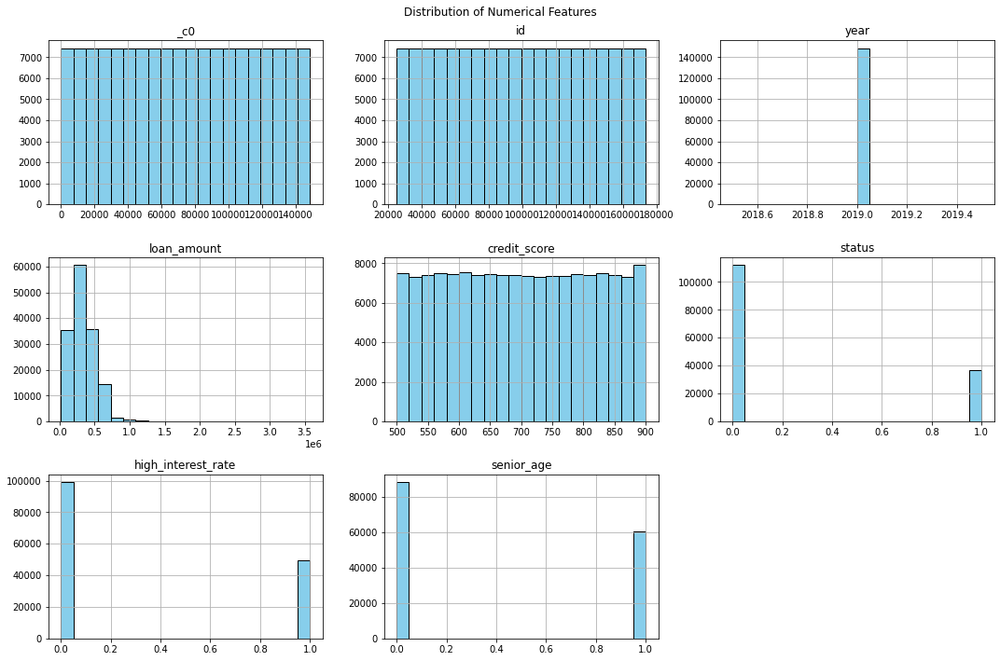

In [0]:
# Select only numeric columns
numeric_cols = [field.name for field in df.schema.fields if isinstance(field.dataType, (IntegerType, FloatType))]

# Collect data to Pandas for visualization
df_numeric = df.select(numeric_cols).toPandas()

# Plot histograms
plt.figure(figsize=(15, 10))
df_numeric.hist(bins=20, figsize=(15, 10), color='skyblue', edgecolor='black')
plt.suptitle("Distribution of Numerical Features")
plt.tight_layout()
plt.show()

### Plot-3: Boxplots for Outliers

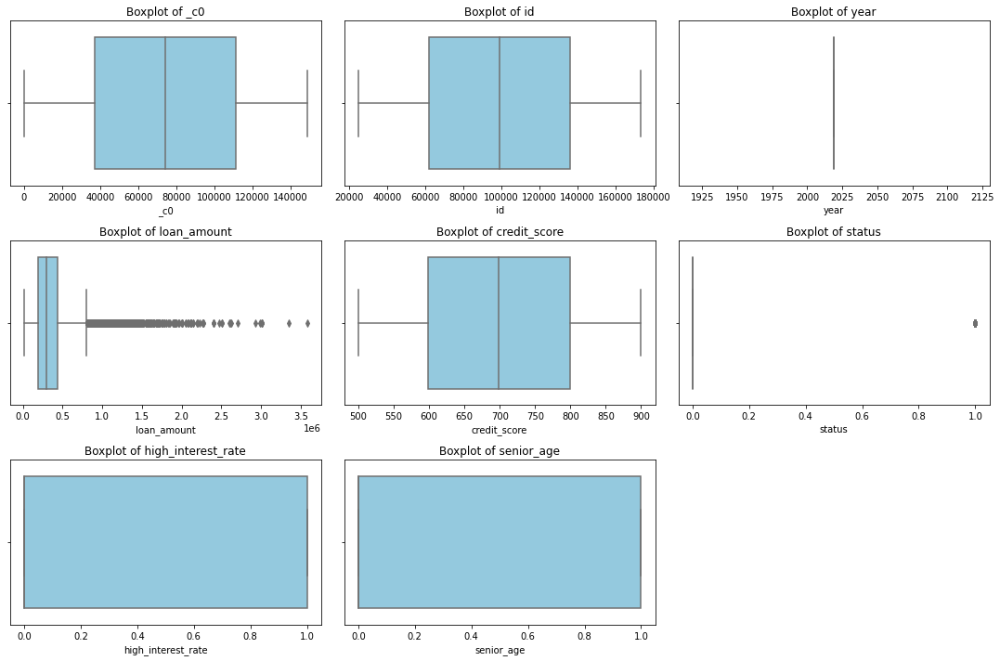

In [0]:
plt.figure(figsize=(15, 10))
for i, col in enumerate(numeric_cols):
    plt.subplot(3, 3, i+1)  # 3x3 grid for boxplots
    sns.boxplot(x=df_numeric[col], color='skyblue')
    plt.title(f'Boxplot of {col}')
plt.tight_layout()
plt.show()

### Plot-4: Correlation Matrix Heatmap

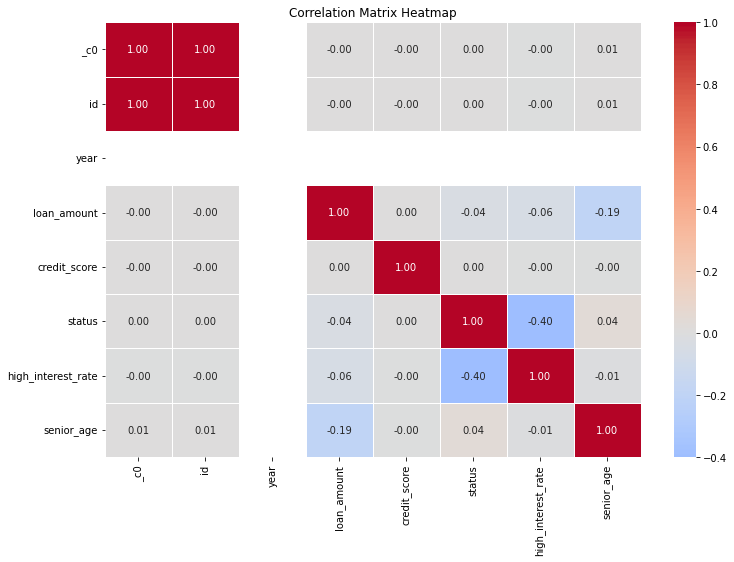

In [0]:
# Compute the correlation matrix for numerical columns
corr_matrix = df_numeric.corr()

# Plot the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', center=0, linewidths=0.5)
plt.title("Correlation Matrix Heatmap")
plt.show()

### Bar Plot for Categorical Features

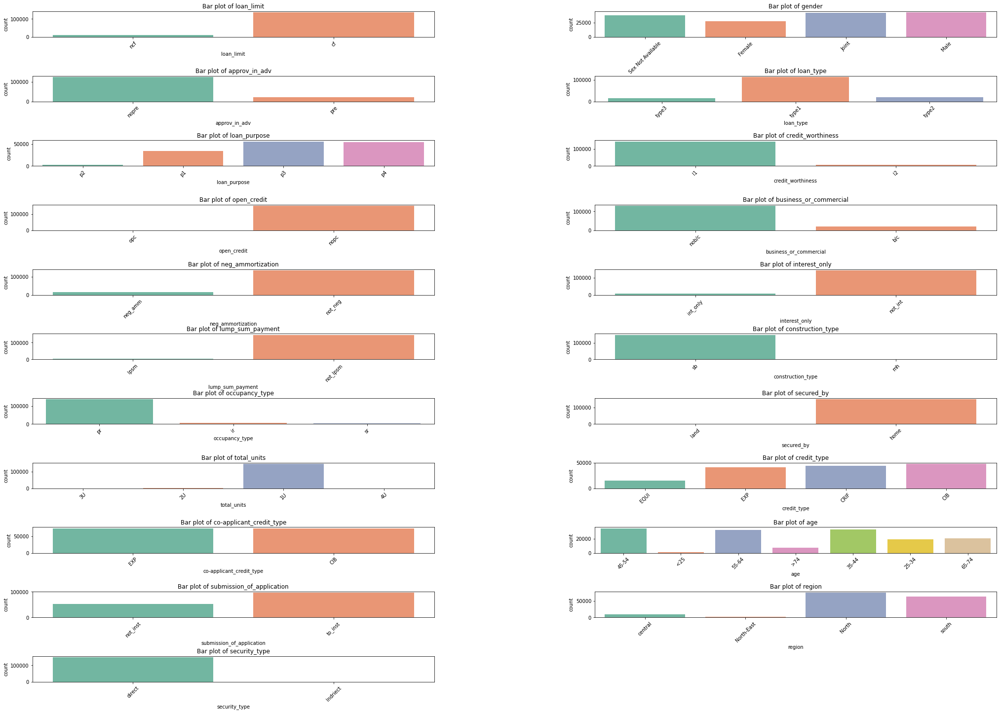

In [0]:
# Select categorical columns
categorical_cols = [field.name for field in df.schema.fields if isinstance(field.dataType, StringType)]

# Number of categorical columns
num_categorical_cols = len(categorical_cols)

# Set number of columns for the subplot grid
num_cols = 2  # Reduce the number of columns to give more space
num_rows = (num_categorical_cols // num_cols) + (1 if num_categorical_cols % num_cols != 0 else 0)

# Create subplots dynamically with a larger figure size
plt.figure(figsize=(35, 25))  # Increase figure size for more space

for i, col in enumerate(categorical_cols):
    plt.subplot(num_rows, num_cols, i + 1)  # Dynamic rows and columns
    # Collect category counts and plot (using PySpark)
    category_counts = df.groupBy(col).count().toPandas()  # Convert to Pandas DataFrame for plotting
    sns.barplot(x=col, y='count', data=category_counts, palette='Set2')
    plt.title(f'Bar plot of {col}')
    plt.xticks(rotation=45)  # Rotate x-axis labels if necessary for better readability

# Adjust layout to add more space between the plots
plt.subplots_adjust(hspace=1.5, wspace=0.4)  # Increase space between subplots
plt.show()

### Pairplot of Numerical Features

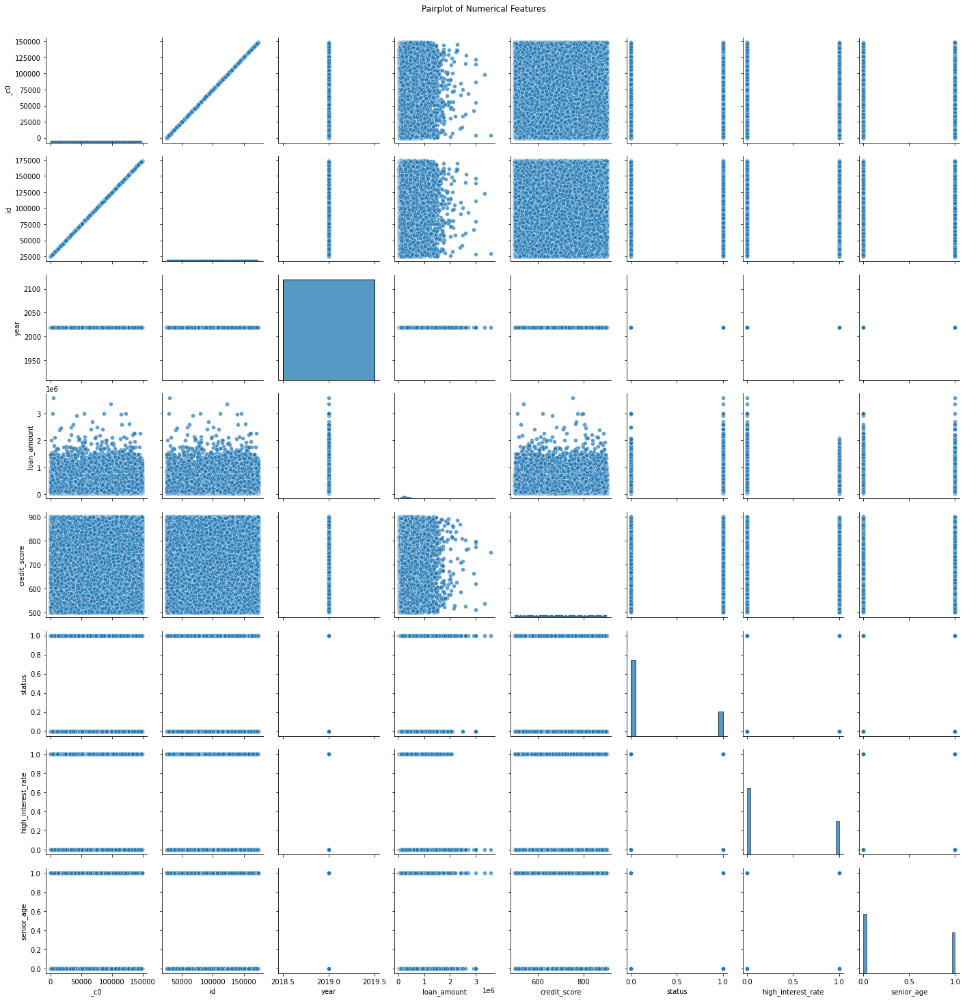

In [0]:
sns.pairplot(df_numeric, kind='scatter', plot_kws={'alpha': 0.7})
plt.suptitle("Pairplot of Numerical Features", y=1.02)
plt.show()

## Data Cleaning and Transformation

In [0]:
from pyspark.sql import functions as F

# Fill NA and null values with 'Unknown' for categorical columns
df_cleaned = df.fillna({
    'loan_limit': 'Unknown', 'gender': 'Unknown', 'approv_in_adv': 'Unknown', 'loan_type': 'Unknown',
    'loan_purpose': 'Unknown', 'credit_worthiness': 'Unknown', 'business_or_commercial': 'Unknown',
    'neg_ammortization': 'Unknown', 'interest_only': 'Unknown', 'lump_sum_payment': 'Unknown',
    'construction_type': 'Unknown', 'occupancy_type': 'Unknown', 'secured_by': 'Unknown',
    'credit_type': 'Unknown', 'co-applicant_credit_type': 'Unknown', 'submission_of_application': 'Unknown',
    'region': 'Unknown', 'security_type': 'Unknown', 'high_interest_rate': 'Unknown', 'senior_age': 'Unknown'
})

# List of numerical columns
numerical_columns = ["loan_amount", "rate_of_interest", "interest_rate_spread", "upfront_charges", 
                     "term", "property_value", "income", "credit_score", "ltv", "dtir1"]

# Fill NA and null values for numerical columns with the median
for column in numerical_columns:
    # Calculate median using approxQuantile
    median_value = df_cleaned.approxQuantile(column, [0.5], 0.1)[0]
    # Replace nulls with median
    df_cleaned = df_cleaned.withColumn(column, F.when(F.col(column).isNull(), median_value).otherwise(F.col(column)))


### Data statistical summary after cleaning

In [0]:

# Display cleaned DataFrame
display(df_cleaned.summary())

summary,_c0,id,year,loan_limit,gender,approv_in_adv,loan_type,loan_purpose,credit_worthiness,open_credit,business_or_commercial,loan_amount,rate_of_interest,interest_rate_spread,upfront_charges,term,neg_ammortization,interest_only,lump_sum_payment,property_value,construction_type,occupancy_type,secured_by,total_units,income,credit_type,credit_score,co-applicant_credit_type,age,submission_of_application,ltv,region,security_type,status,dtir1,high_interest_rate,senior_age
count,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148670,148470,148670,148670,148670,148670,148670,148670,148670,148670
mean,74334.5,99224.5,2019.0,null,null,null,null,null,null,null,null,331117.7439967714,2.8088302616532466,0.40112636106819505,2857.726708347105,335.1434384879263,null,null,null,483686.755902334,null,null,null,null,6835.642160489675,null,699.7891033833322,null,null,null,72.5622953498104,null,null,0.24644514696979888,37.61401762292325,0.3336853433779512,0.40662541198627833
stddev,42917.47659753543,42917.47659753543,0.0,null,null,null,null,null,null,null,null,183909.31012708554,2.224436670978976,0.4509629315197909,2849.979288572711,58.40248809446639,null,null,null,343776.5406647606,null,null,null,null,6311.407820474049,null,115.87585660446848,null,null,null,37.88779888478099,null,null,0.43094220686213175,9.6559005992812,0.4715304131505786,0.49120546541688287
min,0,24890,2019,Unknown,Female,Unknown,type1,Unknown,l1,nopc,b/c,16500.0,-1.0,-3.638,0.0,96.0,Unknown,int_only,lpsm,8000.0,mh,ir,home,1U,0.0,CIB,500.0,CIB,25-34,Unknown,0.967478198,North,Indriect,0,5.0,0,0
25%,37155,62045,2019,null,null,null,null,null,null,null,null,196500.0,2.75,0.1814,1250.0,360.0,null,null,null,288000.0,null,null,null,null,3840.0,null,599.0,null,null,null,63.29787234,null,null,0,33.0,0,0
50%,74323,99213,2019,null,null,null,null,null,null,null,null,296500.0,3.75,0.2772,1847.62,360.0,null,null,null,378000.0,null,null,null,null,5460.0,null,699.0,null,null,null,73.02631579,null,null,0,37.0,0,0
75%,111487,136377,2019,null,null,null,null,null,null,null,null,436500.0,4.25,0.6199,3888.0,360.0,null,null,null,598000.0,null,null,null,null,8280.0,null,800.0,null,null,null,84.72222222,null,null,0,44.0,1,1
max,148669,173559,2019,ncf,Sex Not Available,pre,type3,p4,l2,opc,nob/c,3576500.0,8.0,3.3569999999999998,60000.0,360.0,not_neg,not_int,not_lpsm,1.6508E7,sb,sr,land,4U,578580.0,EXP,900.0,EXP,>74,to_inst,7831.25,south,direct,1,61.0,1,1


## Data Visualizations on cleaned data

### Plot1: Scatter Plot after Cleaning

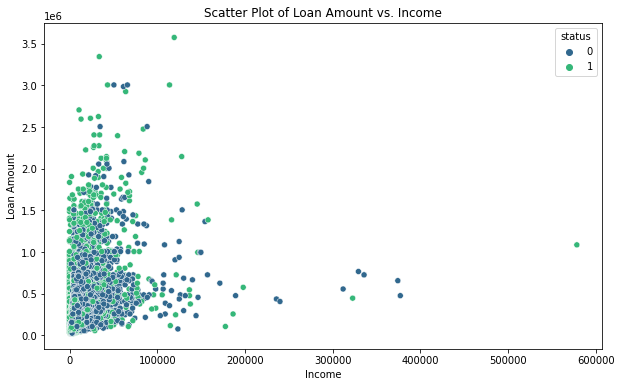

In [0]:
# Convert to Pandas DataFrame
pd_df = df_cleaned.toPandas()

# Scatter Plot of Loan Amount vs. Income
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pd_df, x="income", y="loan_amount", hue="status", palette="viridis")
plt.title('Scatter Plot of Loan Amount vs. Income')
plt.xlabel('Income')
plt.ylabel('Loan Amount')
plt.show()


### Plot2: Box Plot

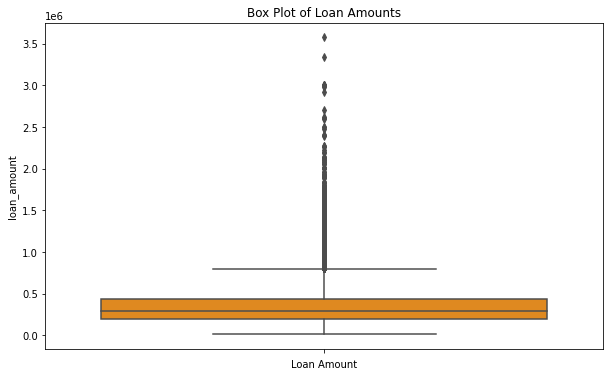

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns


# Box Plot for Loan Amounts
plt.figure(figsize=(10, 6))
sns.boxplot(data=pd_df, y="loan_amount", color='#ff8c00')
plt.title('Box Plot of Loan Amounts')
plt.xlabel('Loan Amount')
plt.show()


### Data Partition

In [0]:

# Split the data into training and testing sets
train_df, test_df = df_cleaned.randomSplit([0.7, 0.3], seed=42)


In [0]:
display(train_df)

_c0,id,year,loan_limit,gender,approv_in_adv,loan_type,loan_purpose,credit_worthiness,open_credit,business_or_commercial,loan_amount,rate_of_interest,interest_rate_spread,upfront_charges,term,neg_ammortization,interest_only,lump_sum_payment,property_value,construction_type,occupancy_type,secured_by,total_units,income,credit_type,credit_score,co-applicant_credit_type,age,submission_of_application,ltv,region,security_type,status,dtir1,high_interest_rate,senior_age
1,24891,2019,cf,Male,nopre,type2,p1,l1,nopc,b/c,206500.0,-1.0,0.2772,1847.62,360.0,not_neg,not_int,lpsm,358000.0,sb,pr,home,1U,4980.0,EQUI,552.0,EXP,55-64,to_inst,70.93301435,North,direct,1,37.0,0,1
2,24892,2019,cf,Male,pre,type1,p1,l1,nopc,nob/c,406500.0,4.56,0.2,595.0,360.0,neg_amm,not_int,not_lpsm,508000.0,sb,pr,home,1U,9480.0,EXP,834.0,CIB,35-44,to_inst,80.01968504,south,direct,0,46.0,1,0
22,24912,2019,cf,Male,pre,type1,p3,l1,nopc,nob/c,306500.0,-1.0,0.2772,1847.62,360.0,not_neg,not_int,not_lpsm,448000.0,sb,pr,home,1U,2880.0,EXP,692.0,CIB,55-64,to_inst,68.41517857,south,direct,1,44.0,0,1
25,24915,2019,Unknown,Joint,nopre,type1,p3,l1,nopc,nob/c,426500.0,4.99,1.2706,169.5,360.0,not_neg,not_int,not_lpsm,568000.0,sb,pr,home,1U,8940.0,EXP,533.0,EXP,45-54,not_inst,75.08802817,North,direct,0,34.0,1,0
32,24922,2019,Unknown,Male,nopre,type1,p1,l1,nopc,nob/c,306500.0,4.125,0.2848,3752.4,360.0,not_neg,not_int,not_lpsm,318000.0,sb,pr,home,1U,5580.0,EXP,701.0,CIB,35-44,not_inst,96.3836478,North,direct,0,37.0,1,0
67,24957,2019,cf,Female,nopre,type2,p4,l1,nopc,b/c,636500.0,-1.0,0.2772,1847.62,360.0,not_neg,int_only,not_lpsm,658000.0,sb,pr,home,1U,12000.0,CIB,741.0,CIB,65-74,to_inst,96.7325228,south,direct,1,36.0,0,1
77,24967,2019,cf,Joint,nopre,type1,p1,l1,nopc,nob/c,306500.0,4.875,0.9155,1330.09,360.0,not_neg,not_int,not_lpsm,408000.0,sb,ir,home,1U,12600.0,CRIF,793.0,EXP,35-44,not_inst,75.12254902,North,direct,0,30.0,1,0
87,24977,2019,cf,Sex Not Available,pre,type3,p4,l1,nopc,nob/c,246500.0,3.75,-0.1094,0.0,360.0,not_neg,not_int,not_lpsm,358000.0,sb,pr,home,1U,4980.0,EXP,511.0,EXP,35-44,to_inst,68.8547486,south,direct,0,37.0,0,0
88,24978,2019,cf,Joint,pre,type1,p3,l1,nopc,nob/c,186500.0,-1.0,0.2772,1847.62,360.0,not_neg,not_int,not_lpsm,288000.0,sb,pr,home,1U,5640.0,CRIF,533.0,EXP,65-74,to_inst,64.75694444,south,direct,1,31.0,0,1
129,25019,2019,cf,Sex Not Available,nopre,type1,p4,l1,nopc,nob/c,706500.0,4.0,0.2072,0.0,360.0,not_neg,not_int,not_lpsm,898000.0,sb,pr,home,1U,15240.0,CRIF,815.0,CIB,45-54,not_inst,78.67483296,North,direct,0,27.0,1,0


## Data Transformation and feature engineering

#### Summary of Data Transformations:

**Transformations**:
- Categorical Encoding: Converting categorical variables to numerical form.
- Feature Scaling: Ensuring that numerical features are on a similar scale.
- Feature Engineering: Creating additional features that might better represent relationships in the data.

In [0]:
# Import necessary libraries

from pyspark.ml.classification import LogisticRegression, NaiveBayes, LinearSVC, RandomForestClassifier
from pyspark.ml.feature import VectorAssembler, Tokenizer
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.ml import Pipeline
import re
import numpy as np

# Pipeline basic to be shared across model fitting and testing
from pyspark.ml.classification import LogisticRegression, NaiveBayes, LinearSVC, RandomForestClassifier
from pyspark.ml.feature import StringIndexer, VectorAssembler
from pyspark.ml import Pipeline
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

indexer_label = StringIndexer(inputCol="status", outputCol="label")
indexed_df = indexer_label.fit(df_cleaned).transform(df_cleaned)
# Initialize base components
indexer = StringIndexer(inputCols=["loan_limit", "gender", "approv_in_adv", "loan_type", "loan_purpose",
                                   "credit_worthiness", "business_or_commercial", "neg_ammortization",
                                   "interest_only", "lump_sum_payment", "construction_type", "occupancy_type",
                                   "secured_by", "credit_type", "submission_of_application","region", "security_type",
                                   "high_interest_rate", "senior_age"],
                        outputCols=["loan_limit_index", "gender_index", "approv_in_adv_index",
                                    "loan_type_index", "loan_purpose_index",
                                    "credit_worthiness_index", "business_or_commercial_index",
                                    "neg_ammortization_index","interest_only_index", "lump_sum_payment_index",
                                    "construction_type_index", "occupancy_type_index","secured_by_index", "credit_type_index",
                                    "submission_of_application_index","region_index", "security_type_index",
                                    "high_interest_rate_index", "senior_age_index"])

assembler = VectorAssembler(inputCols=["year", "loan_amount", "rate_of_interest",       
                                       "interest_rate_spread", "upfront_charges",
                                       "term", "property_value", "income", "credit_score", "ltv", "dtir1",
                                       "loan_limit_index", "gender_index", "approv_in_adv_index", "loan_type_index",
                                       "loan_purpose_index", "credit_worthiness_index", "business_or_commercial_index",
                                       "neg_ammortization_index", "interest_only_index", "lump_sum_payment_index",
                                       "construction_type_index", "occupancy_type_index", "secured_by_index", "credit_type_index",
                                       "submission_of_application_index","region_index", "security_type_index", 
                                       "high_interest_rate_index", "senior_age_index"],
                          outputCol="features")



## Data Modeling

In [0]:

# Pipeline basic to be shared across model fitting and testing
pipeline = Pipeline(stages=[])  # Must initialize with empty list!

# Initialize models
lr = LogisticRegression(maxIter=10, family='multinomial')
nb = NaiveBayes(modelType='gaussian')
svm = LinearSVC(labelCol="label", featuresCol="features")
rf = RandomForestClassifier(numTrees=50)

# Define parameter grids for each model
regParam = [0.01, 0.1]
elasticNetParam = [0.0, 0.5]
smoothing = [0.1, 1.0]
numTrees = [10, 20]
maxDepth = [5, 10]
svmRegParam = [0.01, 0.1]
svmMaxIter = [10, 20]

# Define parameter grids with pipelines
paramgrid_lr = ParamGridBuilder()\
    .baseOn({pipeline.stages: [indexer,indexer_label, assembler, lr]})\
    .addGrid(lr.regParam, regParam)\
    .addGrid(lr.elasticNetParam, elasticNetParam)\
    .build()

paramgrid_nb = ParamGridBuilder()\
    .baseOn({pipeline.stages: [indexer,indexer_label, assembler, nb]})\
    .addGrid(nb.smoothing, smoothing)\
    .build()

paramgrid_svm = ParamGridBuilder()\
    .baseOn({pipeline.stages: [indexer,indexer_label, assembler, svm]})\
    .addGrid(svm.regParam, svmRegParam)\
    .addGrid(svm.maxIter, svmMaxIter)\
    .build()

paramgrid_rf = ParamGridBuilder()\
    .baseOn({pipeline.stages: [indexer,indexer_label, assembler, rf]})\
    .addGrid(rf.numTrees, numTrees)\
    .addGrid(rf.maxDepth, maxDepth)\
    .build()

# Combine all parameter grids into one
paramGrid = paramgrid_lr + paramgrid_nb + paramgrid_svm + paramgrid_rf

# Evaluator Creation
evaluator = MulticlassClassificationEvaluator(metricName='f1')

## All 4 Classification Model Evaluations
  - Logistic Regression
  - Random Forest Classification
  - SVM Model Classification
  - Naive Baye's Model Classification

### Model-1: Logistic Model Evaluation

In [0]:
test_stages_lr = [indexer,indexer_label, assembler,lr] # check a model (place any model here to test it; see config below)
lr_pipe = Pipeline(stages=test_stages_lr)
lr_fitted = lr_pipe.fit(train_df)
lr_results = lr_fitted.transform(test_df)
predictions_lr = lr_results.select('label', 'prediction')

metric_lr = evaluator.evaluate(predictions_lr)
print(f"The Logistic Model Performnce (f1) is {metric_lr}")

The Logistic Model Performnce (f1) is 0.999841962784698


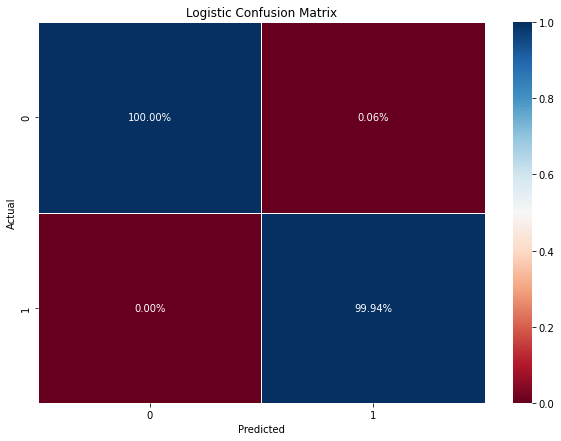

In [0]:
from pyspark.mllib.evaluation import MulticlassMetrics

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Confusion matrix from labels and predictions
metrics = MulticlassMetrics(predictions_lr.select('label', 'prediction').rdd.map(tuple))
confusion_matrix = metrics.confusionMatrix().toArray()

# Pandas DataFrame from Spark confusion matrix
cnf_matrix = pd.DataFrame(confusion_matrix)

plt.figure(figsize = (10,7))
p = sns.heatmap(cnf_matrix/np.sum(cnf_matrix), annot=True, fmt=".2%", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu')
# If you want numbers, instead of percent
# p = sns.heatmap(cnf_matrix, annot=True, fmt=",.1f", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu');

p.set(xlabel='Predicted', ylabel='Actual', title='Logistic Confusion Matrix');

### Model-2: NaiveBayes Model Evaluation

In [0]:
test_stages_nb = [indexer,indexer_label, assembler,nb] # check a model (place any model here to test it; see config below)
nb_pipe = Pipeline(stages=test_stages_nb)
nb_fitted = nb_pipe.fit(train_df)
nb_results = nb_fitted.transform(test_df)
predictions_nb = nb_results.select('label', 'prediction')

metric_nb = evaluator.evaluate(predictions_nb)
print(f"The NaiveBayes Model Performnce (f1) is {metric_nb}")

The NaiveBayes Model Performnce (f1) is 0.9249311326173898


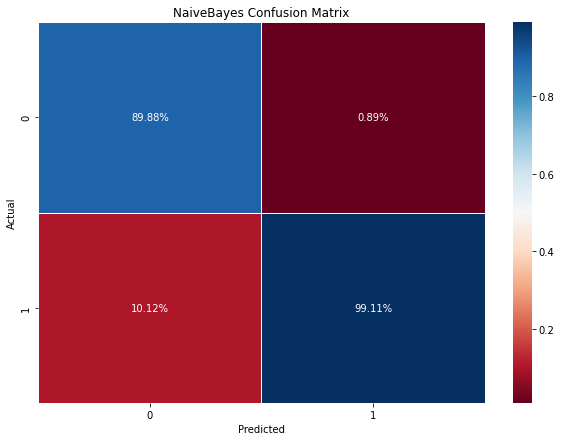

In [0]:
from pyspark.mllib.evaluation import MulticlassMetrics

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Confusion matrix from labels and predictions
metrics = MulticlassMetrics(predictions_nb.select('label', 'prediction').rdd.map(tuple))
confusion_matrix = metrics.confusionMatrix().toArray()

# Pandas DataFrame from Spark confusion matrix
cnf_matrix = pd.DataFrame(confusion_matrix)

plt.figure(figsize = (10,7))
p = sns.heatmap(cnf_matrix/np.sum(cnf_matrix), annot=True, fmt=".2%", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu')
# If you want numbers, instead of percent
# p = sns.heatmap(cnf_matrix, annot=True, fmt=",.1f", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu');

p.set(xlabel='Predicted', ylabel='Actual', title='NaiveBayes Confusion Matrix');

### Model-3: Support Vector Machine Model

In [0]:
test_stages_svm = [indexer,indexer_label, assembler,svm] # check a model (place any model here to test it; see config below)
svm_pipe = Pipeline(stages=test_stages_svm)
svm_fitted = svm_pipe.fit(train_df)
svm_results = svm_fitted.transform(test_df)
predictions_svm = svm_results.select('label', 'prediction')

metric_svm = evaluator.evaluate(predictions_svm)
print(f"The Support Vector Machine Model Performnce (f1) is {metric_svm}")

The Support Vector Machine Model Performnce (f1) is 1.0


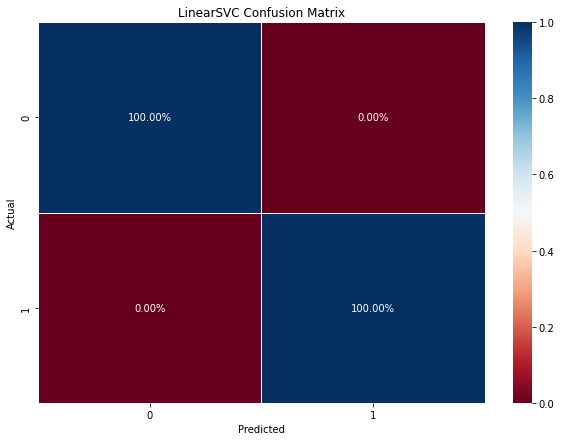

In [0]:
from pyspark.mllib.evaluation import MulticlassMetrics

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Confusion matrix from labels and predictions
metrics = MulticlassMetrics(predictions_svm.select('label', 'prediction').rdd.map(tuple))
confusion_matrix = metrics.confusionMatrix().toArray()

# Pandas DataFrame from Spark confusion matrix
cnf_matrix = pd.DataFrame(confusion_matrix)

plt.figure(figsize = (10,7))
p = sns.heatmap(cnf_matrix/np.sum(cnf_matrix), annot=True, fmt=".2%", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu')
# If you want numbers, instead of percent
# p = sns.heatmap(cnf_matrix, annot=True, fmt=",.1f", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu');

p.set(xlabel='Predicted', ylabel='Actual', title='LinearSVC Confusion Matrix');

### Model-4: RandomForestClassifier Model Evaluation

In [0]:
test_stages_rf = [indexer,indexer_label, assembler,svm] # check a model (place any model here to test it; see config below)
rf_pipe = Pipeline(stages=test_stages_rf)
rf_fitted = rf_pipe.fit(train_df)
rf_results = rf_fitted.transform(test_df)
predictions_rf = rf_results.select('label', 'prediction')

metric_rf = evaluator.evaluate(predictions_rf)
print(f"The RandomForestClassifier Model Performnce (f1) is {metric_rf}")

The RandomForestClassifier Model Performnce (f1) is 1.0


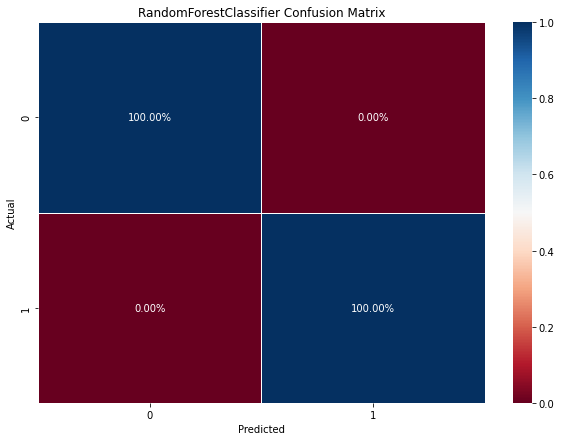

In [0]:
from pyspark.mllib.evaluation import MulticlassMetrics

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Confusion matrix from labels and predictions
metrics = MulticlassMetrics(predictions_rf.select('label', 'prediction').rdd.map(tuple))
confusion_matrix = metrics.confusionMatrix().toArray()

# Pandas DataFrame from Spark confusion matrix
cnf_matrix = pd.DataFrame(confusion_matrix)

plt.figure(figsize = (10,7))
p = sns.heatmap(cnf_matrix/np.sum(cnf_matrix), annot=True, fmt=".2%", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu')
# If you want numbers, instead of percent
# p = sns.heatmap(cnf_matrix, annot=True, fmt=",.1f", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu');

p.set(xlabel='Predicted', ylabel='Actual', title='RandomForestClassifier Confusion Matrix');

## CrossValidation on 4 Models
  - multi-model pipeline

In [0]:
# The common empty pipeline
# The common evaluator
# The paramGrid, which includes models and their pipelines
cv = CrossValidator()\
      .setEstimator(pipeline)\
      .setEvaluator(evaluator)\
      .setEstimatorParamMaps(paramGrid)\
      .setNumFolds(2) \
      .setParallelism(4)


fitted_grid = cv.fit(train_df)
print(f"model averages: {fitted_grid.avgMetrics}")

model averages: [0.9985907277689487, 0.998600301140838, 0.9984949018040179, 0.998600301140838, 0.9230816900130214, 0.9230816900130214, 0.9986099108189419, 0.9986099108189419, 0.9985907277689487, 0.9986099108189419, 0.9999903902883761, 0.9999903902883761, 0.9999903902883761, 0.9999903902883761]


In [0]:
import numpy as np
num_models = len(fitted_grid.getEstimatorParamMaps())
print(f"Ran {num_models} models")
print(f"Model metrics are: {fitted_grid.avgMetrics}")

Ran 14 models
Model metrics are: [0.9985907277689487, 0.998600301140838, 0.9984949018040179, 0.998600301140838, 0.9230816900130214, 0.9230816900130214, 0.9986099108189419, 0.9986099108189419, 0.9985907277689487, 0.9986099108189419, 0.9999903902883761, 0.9999903902883761, 0.9999903902883761, 0.9999903902883761]


## Evaluate models (from multi-model pipeline)

In [0]:
import numpy as np

print("Best Model:")
print(fitted_grid.getEstimatorParamMaps()[ np.argmax(fitted_grid.avgMetrics) ])
print()  # This adds a blank line between the outputs
print("Worst Model:")
print (fitted_grid.getEstimatorParamMaps()[ np.argmin(fitted_grid.avgMetrics) ])

Best Model:
{Param(parent='Pipeline_e6e4c78d243b', name='stages', doc='a list of pipeline stages'): [StringIndexer_6b8838e95b3a, StringIndexer_7a634efc409b, VectorAssembler_336c86a1937b, RandomForestClassifier_e7dbe440b985], Param(parent='RandomForestClassifier_e7dbe440b985', name='numTrees', doc='Number of trees to train (>= 1).'): 10, Param(parent='RandomForestClassifier_e7dbe440b985', name='maxDepth', doc='Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes. Must be in range [0, 30].'): 5}

Worst Model:
{Param(parent='Pipeline_e6e4c78d243b', name='stages', doc='a list of pipeline stages'): [StringIndexer_6b8838e95b3a, StringIndexer_7a634efc409b, VectorAssembler_336c86a1937b, NaiveBayes_c698fb9d2a5e], Param(parent='NaiveBayes_c698fb9d2a5e', name='smoothing', doc='The smoothing parameter, should be >= 0, default is 1.0'): 0.1}


In [0]:
import re
from pyspark.ml.tuning import CrossValidatorModel

def paramGrid_model_name(model):
  params = [v for v in model.values() if type(v) is not list]
  name = [v[-1] for v in model.values() if type(v) is list][0]
  name = re.match(r'([a-zA-Z]*)', str(name)).groups()[0]
  return f"{name}{params}"


def cv_metrics(cv: CrossValidatorModel):
  """
  Returns metrics and model names when CrossValidator is used to run multiple models, in parameter pipelines.
  """
  # Resulting metric and model description
  # get the metric from the CrossValidator's resulting avgMetrics
  # get the model name & params from the paramGrid
  # put them together here:
  measures = zip(cv.avgMetrics, [paramGrid_model_name(m) for m in cv.getEstimatorParamMaps()])
  metrics, model_names = zip(*measures)
  return metrics, model_names

metrics, model_names = cv_metrics(fitted_grid)

metric_name = fitted_grid.getEvaluator().getMetricName()
print(metric_name)

f1


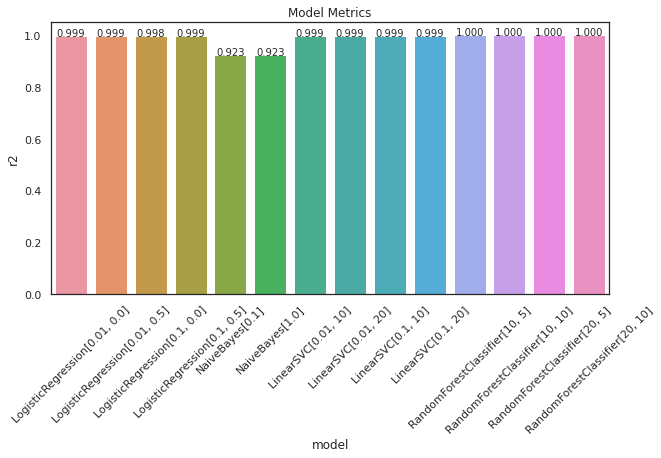

In [0]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_context('notebook')
sns.set_style('white')
sns.set_palette("bright")

def add_metric_labels(metrics):
    for i in range(len(metrics)):
        plt.text(i, metrics[i], f"{metrics[i]:.3f}", ha = 'center', fontsize=10)

plt.figure(figsize=(10, 5))

pdf = pd.DataFrame(zip(metrics, model_names), columns=['r2', 'model'])
sns.barplot(data=pdf, x='model', y='r2').set(title="Model Metrics")
plt.xticks(rotation=45)
add_metric_labels(metrics)

In [0]:
from pyspark.sql import DataFrame
import pyspark.sql.functions as F
import pyspark.sql.types as T
from pyspark.mllib.evaluation import BinaryClassificationMetrics, MulticlassMetrics
# import sparkdl

def feature_importance(model, predictions, schema_name='features'):
  """
  Given (non-regression) model and it's predictions, 
  Returns Pandas DataFrame of features scores, sorted by importance.
  """
  idxs = [f['idx'] for f in predictions.schema[schema_name].metadata["ml_attr"]["attrs"]['numeric']]
  names = [f['name'] for f in predictions.schema[schema_name].metadata["ml_attr"]["attrs"]['numeric']]

  scores = list(model.featureImportances.toArray())
  pdf = pd.DataFrame(list(zip(idxs, names, scores)),columns = ['index','name', 'score'])
  pdf.sort_values('score', ascending=False, inplace=True)
  return pdf


def classification_metrics(predictions: DataFrame, label='label', prediction='prediction'):
  """
  Summary metrics (ROC, PR, etc.) for given predictions.
  Returned metrics dictionary, and the confusion matrix.
  Provides F-measure using beta values: https://machinelearningmastery.com/fbeta-measure-for-machine-learning
  A smaller beta value, such as 0.5, gives more weight to precision and less to recall, 
  whereas a larger beta value, such as 2.0, gives less weight to precision and more weight to recall in the calculation of the score.
  For stocks, we are interested in precision (correctly calling positive increases)
  """
  metrics_b = BinaryClassificationMetrics(predictions.select(label, prediction).rdd.map(tuple))
  metrics = {}
  metrics['PR AUC'] = metrics_b.areaUnderPR
  metrics['ROC AUC'] = metrics_b.areaUnderROC
  metrics_m = MulticlassMetrics(predictions.select(label, prediction).rdd.map(tuple))
  metrics['F0.5 Score'] = metrics_m.fMeasure(label=1.0, beta=0.5)
  metrics['F1 Score'] = metrics_m.fMeasure(label=1.0, beta=1.0)
  metrics['F2 Score'] = metrics_m.fMeasure(label=1.0, beta=2.0)
  metrics['Recall'] = metrics_m.recall(label=1)
  metrics['Precision'] = metrics_m.precision(1)
  metrics['Accuracy'] = metrics_m.accuracy
  return metrics, metrics_m.confusionMatrix().toArray()


def precision_recall(pred_df: DataFrame, col_name):
  """
  Output: precision, recall used in evaluation function
  """
  rdd_pred = pred_df.select([col_name, 'label']).rdd
  metrics_m = MulticlassMetrics(rdd_pred)
  precision = metrics_m.precision(1)
  recall = metrics_m.recall(label=1)
  f2 = metrics_m.fMeasure(1.0, 2.0)
  f1 = metrics_m.fMeasure(1.0, 1.0)
  f05 = metrics_m.fMeasure(1.0, 0.5)
  return (precision, recall, f2, f1, f05)  

def threshold_tuning(valid_df: DataFrame):
  """
  Input: a validated df
  Output: a panda df that contains thresholds from 0-1 and associated precision/recall/f2 score
  """
  pr_results = []
  preds_new = valid_df
  preds_new = preds_new.withColumn('pred_probability', firstelement('probability'))
  thresholds = np.arange(start=0.1, stop=1.1, step=0.1)
  c = ['c1','c2','c3','c4','c5','c6','c7','c8','c9','c10']
  i=0
  for threshold in thresholds:
    preds_new = preds_new.withColumn(c[i], F.when(preds_new["pred_probability"].cast(T.DoubleType()) >= threshold , 1.0).otherwise(0.0).cast(T.DoubleType()))
    i = i+1
  for i in range(len(thresholds)-1):                       
    precision, recall, f2, f1, f05 = precision_recall(preds_new, c[i])
    pr_results.append((thresholds[i], precision, recall, f2, f1, f05))
  pr_df = pd.DataFrame(pr_results).rename(columns={0:'Threshold',1:'Precision',2:'Recall', 3:'f2-score', 4:'f1-score', 5:'f0.5-score'})
  return pr_df  

# Function to graph first position of the dense vector probability
# Used in threshold_tuning function
firstelement = udf(lambda item:float(item[1]),T.FloatType())


class CurveMetrics(BinaryClassificationMetrics):
  """
  Helper function to plot roc curve
  """
  def __init__(self, *args):
      super(CurveMetrics, self).__init__(*args)
  def _to_list(self, rdd):
      points = []
      for row in rdd.collect():
          # Results are returned as type scala.Tuple2, 
          # which doesn't appear to have a py4j mapping
          points += [(float(row._1()), float(row._2()))]
      return points
  def get_curve(self, method):
      rdd = getattr(self._java_model, method)().toJavaRDD()
      return self._to_list(rdd)
    

def evaluate(preds_train: DataFrame, preds_valid: DataFrame, model, label='label', features='features', cm_percent=True):
  """
  Input: predicted model for train and validation set, model
  Output: PySpark DataFrame of evaluation metrics for class 0, 1 
  Confusion Matrix, PR-Curve
  """
  
  print(str(model))
  tr_metrics, _ = classification_metrics(preds_train)
  ts_metrics, confusion_matrix = classification_metrics(preds_valid)
  print(f"{'Metric': <10} {'Train': >7} {'Test': >7}")
  for key in tr_metrics.keys():
    print(f"{key: <10} {tr_metrics[key]: >7,.4f} {ts_metrics[key]: >7,.4f}")      
  
  print('                                        Validation Plots')
  fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 12))
   
  preds_valid_pr = threshold_tuning(preds_valid)
  # plot the Precision-Recall curve  
  sns.set(font_scale=1, style='whitegrid')
  sns.lineplot(x='Recall', y='Precision', data=preds_valid_pr, label='PR Curve', ax=axes[0,0])
  axes[0,0].set_title('Precision-Recall Curve')
  axes[0,0].legend()
   
  # Used by plot ROC AUC
  rdd_valid_b = preds_valid.select(label,'probability').rdd.map(lambda row: (float(row['probability'][1]), float(row[label])))  
  # plot ROC AUC
  metrics_valid = CurveMetrics(rdd_valid_b)
  points_roc = metrics_valid.get_curve('roc')
  x_val = [x[0] for x in points_roc]
  y_val = [x[1] for x in points_roc]
  sns.lineplot(x=x_val, y=y_val, color='lightsteelblue',label='ROC AUC',ax= axes[1,0])  
  # Get the xy data from the lines so that we can shade
  l1 = axes[1,0].lines[0]
  x1 = l1.get_xydata()[:,0]
  y1 = l1.get_xydata()[:,1]
  axes[1,0].fill_between(x1,y1, color="lightblue", alpha=0.3)
  axes[1,0].set_ylim([0.1, 1])
  axes[1,0].set_xlabel('FPR (1-Specificity)')
  axes[1,0].set_ylabel('TPR (Recall)')
  axes[1,0].set_title('ROC AUC curve (Validation)')
  axes[1,0].legend()
    
  # Plot confusion matrix
  cm = confusion_matrix
  confusion_matrix = pd.DataFrame(cm)
  if cm_percent:
    sns.heatmap(confusion_matrix/np.sum(confusion_matrix), annot=True, fmt=".1%", linewidth=0.5, cmap='Blues', ax=axes[1,1])
  else:
    sns.heatmap(cnf_matrix, annot=True, fmt=",.1f", linewidth=0.5, annot_kws={'fontsize':10}, cmap='RdBu', ax=axes[1,1])  
  size = int(preds_valid.count())
  size = f'{size:,}'
  axes[1,1].set_title('Confusion Matrix - N={}'.format(size))
  axes[1,1].set_ylabel('Actual Values')
  axes[1,1].set_xlabel('Predicted Values')
  plt.show()
  
  # Features
  try:
    pdf = feature_importance(model, preds_valid, schema_name=features)
    sns.catplot(data=pdf, y='name', x='score', kind='bar', orient='h', height=7, aspect=1.7).set(title='Feature Importance');
    plt.show()
  except AttributeError:
    print("Cannot display feature importance")
    pass

In [0]:
model = fitted_grid.bestModel.stages[-1]
train_predictions = fitted_grid.bestModel.transform(train_df)
test_predictions = fitted_grid.bestModel.transform(test_df)

In [0]:
#display(test_predictions)
display(test_predictions.select('features', 'status', 'probability', 'prediction'))

features,status,probability,prediction
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 18, 24, 29), values -> List(2019.0, 156500.0, -1.0, 0.2772, 1847.62, 360.0, 168000.0, 3120.0, 534.0, 93.15476190000001, 44.0, 1.0, 1.0, 1.0, 1.0))",1,"Map(vectorType -> dense, length -> 2, values -> List(0.09615945580864867, 0.9038405441913513))",1.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 24, 25), values -> List(2019.0, 396500.0, -1.0, 0.2772, 1847.62, 360.0, 418000.0, 7560.0, 799.0, 94.85645933, 42.0, 1.0, 1.0, 1.0))",1,"Map(vectorType -> dense, length -> 2, values -> List(0.15425115605972367, 0.8457488439402763))",1.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 17, 24, 25), values -> List(2019.0, 226500.0, 3.625, 0.5626, 1847.62, 360.0, 258000.0, 3720.0, 820.0, 87.79069767, 40.0, 2.0, 3.0, 1.0, 1.0, 1.0, 1.0))",0,"Map(vectorType -> dense, length -> 2, values -> List(0.9867909560613489, 0.013209043938651188))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 25), values -> List(2019.0, 486500.0, 3.875, -0.1583, 7305.0, 360.0, 1198000.0, 8580.0, 812.0, 40.60934891, 33.0, 1.0, 1.0))",0,"Map(vectorType -> dense, length -> 2, values -> List(0.9607861862020682, 0.039213813797931825))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 14, 15, 24, 26), values -> List(2019.0, 586500.0, 3.5, -0.2979, 2800.0, 360.0, 588000.0, 7140.0, 732.0, 99.74489796, 49.0, 1.0, 2.0, 2.0, 2.0, 1.0))",0,"Map(vectorType -> dense, length -> 2, values -> List(0.9607706907344925, 0.03922930926550756))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 24, 25, 28, 29), values -> List(2019.0, 186500.0, 4.875, 0.3555, 4950.0, 360.0, 348000.0, 2880.0, 506.0, 53.59195402, 46.0, 2.0, 2.0, 1.0, 1.0, 1.0))",0,"Map(vectorType -> dense, length -> 2, values -> List(0.9996163100734863, 3.836899265136242E-4))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 15, 17, 24, 25, 26), values -> List(2019.0, 496500.0, -1.0, 0.2772, 1847.62, 360.0, 508000.0, 6060.0, 613.0, 97.73622047, 56.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0))",1,"Map(vectorType -> dense, length -> 2, values -> List(0.08722884963063107, 0.912771150369369))",1.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 5, 6, 7, 8, 9, 10, 12, 15, 25, 26), values -> List(2019.0, 376500.0, 3.875, 0.017, 360.0, 608000.0, 4680.0, 755.0, 61.92434211, 41.0, 2.0, 1.0, 1.0, 1.0))",0,"Map(vectorType -> dense, length -> 2, values -> List(0.9865144165759832, 0.013485583424016867))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 26, 28), values -> List(2019.0, 156500.0, 4.625, 1.0547, 4115.0, 360.0, 258000.0, 3960.0, 820.0, 60.65891473, 31.0, 1.0, 1.0))",0,"Map(vectorType -> dense, length -> 2, values -> List(0.9996163100734863, 3.836899265136242E-4))",0.0
"Map(vectorType -> sparse, length -> 30, indices -> List(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 15, 24, 25, 26), values -> List(2019.0, 486500.0, 3.375, -0.1318, 169.53, 360.0, 618000.0, 9000.0, 674.0, 78.72168285, 30.0, 1.0, 2.0, 1.0, 1.0))",0,"Map(vectorType -> dense, length -> 2, values -> List(0.9867930617837659, 0.013206938216234018))",0.0


### Best Model Evaluation

RandomForestClassificationModel: uid=RandomForestClassifier_e7dbe440b985, numTrees=10, numClasses=2, numFeatures=30
Metric       Train    Test
PR AUC      0.9989  0.9989
ROC AUC     0.9998  0.9998
F0.5 Score  0.9991  0.9991
F1 Score    0.9995  0.9995
F2 Score    0.9998  0.9998
Recall      1.0000  1.0000
Precision   0.9989  0.9989
Accuracy    0.9997  0.9997
                                        Validation Plots


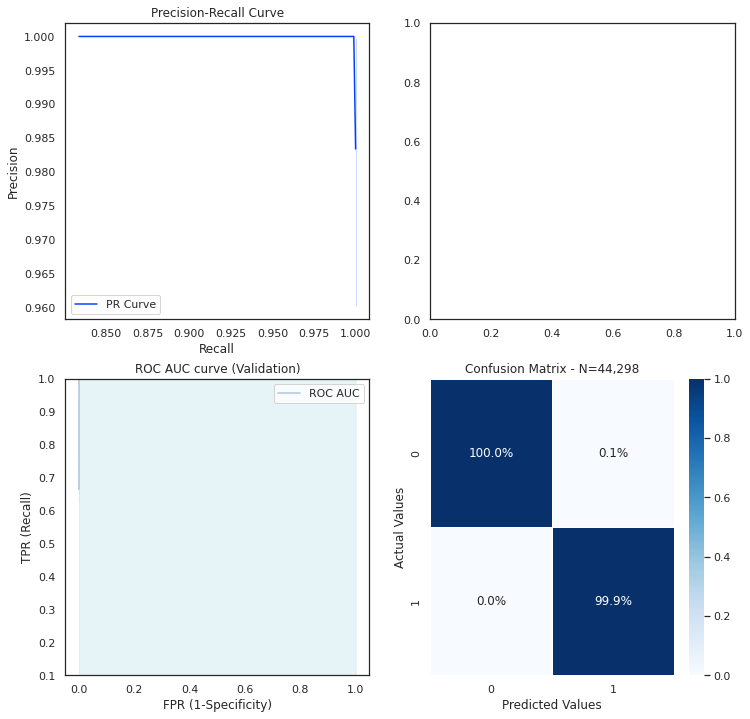

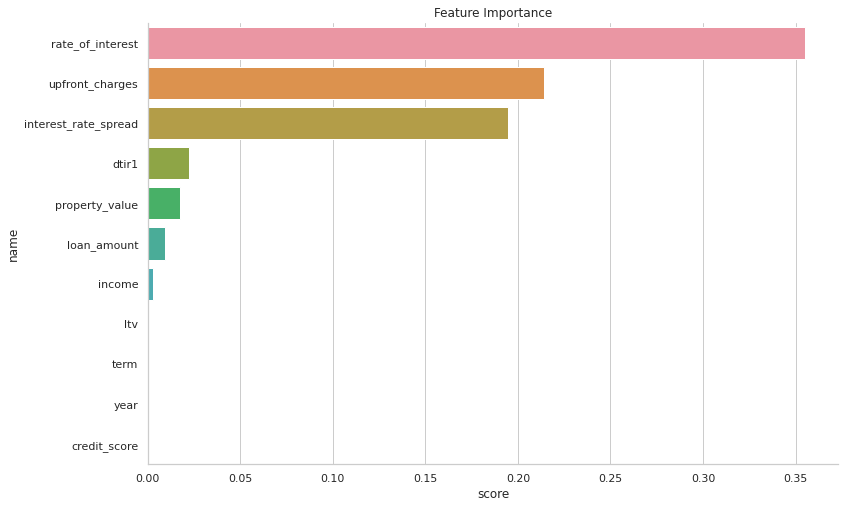

In [0]:
evaluate(train_predictions, test_predictions, model, features='features')